In [1]:
# Imoport packages
import plotly.express as px
import pandas as pd 
import geopandas as gpd
import json

# Import function 
from maps import convert_shapefiles

----

## Neighborhoods map 
A map of Chicago broken down by neigborhoods.

Setps: 
1. Load geojson file with shape files for Chicago at the community level
2. Extract community names and build a data frame with data set
3. Build a map to the community level

In [3]:
# # Convert shapefile to feodata
# shape_file = "../data/geodata/Neighborhoods_2012b"
# convert_shapefiles(shape_file, ".shx")

In [24]:
# Load geodata
file = open("Boundaries - Community Areas (current).geojson")
geo_communities = json.load(file)
file.close()

# type(geo_communities)
# geo_communities

In [25]:
chicago_communities = []
for community in geo_communities["features"]:
    chicago_communities.append(community["properties"]["community"])

df = pd.DataFrame(chicago_communities, columns = ["community_name"])

# Data frame with sample data
df["trial_numbers"] = range(50, 50 + len(df))


In [26]:
# Documentation for choroplet maps 
# https://plotly.com/python/county-choropleth/

# Map!
fig = px.choropleth(
    # Data frame with variables of interest
    df, 
    # Geojson with geography 
    geojson = geo_communities, 
    # Variable that is to be mapped as color
    color = "trial_numbers",
    # Key in geojson to link with data frame
    featureidkey = "properties.community",
    locations = "community_name", 
    # Coordinate to center the map around
    center = dict(lat = 41.8781, lon = -87.6298), 
    # 
    projection = "mercator"
)

# Adjust zoom to display Chicago (based on the shapefile)
fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

-----

# Zip codes
1. Load geojson file with shape files for Chicago at the zip code level
2. Extract zip codes names and build a data frame with data set
3. Build a map to the zip code level

In [29]:
# Load geodata for zip codes
# shape_file = "../data/geodata/Neighborhoods_2012b"
file = open("../data/chicago_city_geodata/Boundaries - ZIP Codes.geojson")
geo_zip_codes = json.load(file)
file.close()

# geo_zip_codes

In [19]:
# Building a trial dataset 
chicago_zip_codes= []

for zip in geo_zip_codes["features"]:
    # print(zip["properties"]["zip"])
    chicago_zip_codes.append(zip["properties"]["zip"])

# Build a data set with all zip codes
df = pd.DataFrame(chicago_zip_codes, columns = ["zip"])
df["trial_numbers"] = range(50, 50 + len(df))
# df

In [22]:
# Map!
fig = px.choropleth(
    # Data frame with variables of interest
    df, 
    # Geojson with geography 
    geojson = geo_zip_codes, 
    # Variable that is to be mapped as color
    color = "trial_numbers",
    # Key in geojson to link with data frame
    featureidkey = "properties.zip",
    locations = "zip", 
    # Coordinate to center the map around
    center = dict(lat = 41.8781, lon = -87.6298), 
    # 
    projection = "mercator"
)

# Adjust zoom to display Chicago (based on the shapefile)
fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

-------

# Bus stops!!!

In [39]:
# Load stops data 
shape_file = "../data/CTA_BusStops_geodata/CTA_BusStops.shx"
geo_bus_stops = gpd.read_file(shape_file)
type(geo_bus_stops)
geo_bus_stops

,SYSTEMSTOP,STREET,CROSS_ST,DIR,POS,ROUTESSTPG,OWLROUTES,CITY,PUBLIC_NAM,geometry
0,5282.0,JEFFERY,97TH STREET,NB,MT,15,None,CHICAGO,Jeffery & 97th Street,POINT (-87.57521 41.71888)
1,1143.0,STOCKTON,WEBSTER,NB,NT,"151,156",None,CHICAGO,Stockton & Webster,POINT (-87.63563 41.92192)
2,15703.0,HARLEM,SCHNEIDER,NB,NS,90,None,OAK PARK,Harlem & Schneider,POINT (-87.80512 41.89619)
3,6501.0,WENTWORTH,3200 SOUTH,SB,MB,"24,31",None,CHICAGO,3200 S Wentworth,POINT (-87.63168 41.83648)
4,1593.0,MICHIGAN,14TH STREET,SB,FS,"1,3,4",N4,CHICAGO,Michigan & 14th Street,POINT (-87.62419 41.86388)
...,...,...,...,...,...,...,...,...,...,...
10755,18379.0,HARLEM,AUGUSTA,NB,FS,90,None,OAK PARK,Harlem & Augusta,POINT (-87.80521 41.89799)
10756,18084.0,69TH STREET,DAMEN,EB,FS,67,None,CHICAGO,69th Street & Damen,POINT (-87.67337 41.76837)
10757,10274.0,CICERO,21ST STREET,NB,NS,54,None,CICERO,Cicero & 21st Street,POINT (-87.74420 41.85310)
10758,7111.0,STONY ISLAND,84TH STREET,NB,NS,28,None,CHICAGO,Stony Island & 84th Street,POINT (-87.58530 41.74246)


In [49]:
# Documentation for scatterplots on maps
# https://plotly.com/python/scatter-plots-on-maps/
import plotly.graph_objects as go
import pandas as pd

fig = px.scatter_geo(geo_bus_stops, 
                lat = geo_bus_stops.geometry.y, 
                lon = geo_bus_stops.geometry.x, 
                hover_name = "PUBLIC_NAM")


fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

----------

## Bus routes!!

Neighborhoods, zip codes and bus stations are done! 
Let's do bus routes now 🤠

In [104]:
# Load data 
shape_file = "../data/CTA_BusRoutes_geodata/CTA_BusRoutes.shx"
geo_bus_routes = gpd.read_file(shape_file)
type(geo_bus_routes)
geo_bus_routes

,ROUTE,ROUTE0,NAME,WKDAY,SAT,SUN,SHAPE_LEN,geometry
0,12,012,ROOSEVELT,1,1,1,62586.111408,"MULTILINESTRING ((1170944.365 1894917.516, 117..."
1,121,121,UNION/STREETERVILLE EXPRESS,1,0,0,24090.823988,"MULTILINESTRING ((1177256.972 1902694.559, 117..."
2,1,001,BRONZEVILLE/UNION STATION,1,0,0,34690.953676,"MULTILINESTRING ((1177767.298 1881817.345, 117..."
3,108,108,HALSTED/95TH,1,0,0,71888.990825,"MULTILINESTRING ((1187238.580 1818029.606, 118..."
4,11,011,LINCOLN,1,1,1,24694.573889,"MULTILINESTRING ((1159525.760 1931136.456, 115..."
...,...,...,...,...,...,...,...,...
123,120,120,OGILVIE/STREETERVILLE EXPRESS,1,0,0,19816.037215,"MULTILINESTRING ((1177256.972 1902694.559, 117..."
124,126,126,JACKSON,1,1,1,67746.952693,"MULTILINESTRING ((1136605.121 1898072.170, 113..."
125,20,020,MADISON,1,1,1,54335.296018,"MULTILINESTRING ((1136594.654 1899387.714, 113..."
126,128,128,SOLDIER FIELD EXPRESS,0,0,0,24871.988685,"MULTILINESTRING ((1179372.762 1894217.397, 117..."


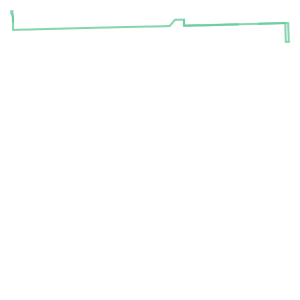

In [118]:
# If I extract the geometry attribute and display it, it shows the route
geo_bus_routes["geometry"][0]

In [ ]:
# It seems like there're basically two functions 
px.line_geo()
px.line_mapbox()

In [125]:
# identify data type of the route

import shapely.geometry

isinstance(geo_bus_routes["geometry"][0], 
           shapely.geometry.multilinestring.MultiLineString)

# type(geo_bus_routes["geometry"][0])

True

In [129]:
# Documentation for Lines on Maps from GeoPandas
# https://plotly.com/python/lines-on-maps/
import numpy as np

lats = []
lons = []
names = []

# Break down multilinestrings into lists that plotly can parse 
for _, route in geo_bus_routes.iterrows():
    # Extract multiline from route 
    route_linestrings = route["geometry"].geoms

    for linestring in route_linestrings:
        x, y = linestring.xy
        lats = np.append(lats, y)
        lons = np.append(lons, x)
        names = np.append(names, [route["NAME"]]*len(y))
        lats = np.append(lats, None)
        lons = np.append(lons, None)
        names = np.append(names, None)



In [130]:
# Documentation for lines on maps in python 
# https://plotly.com/python/lines-on-maps/
fig = px.line_geo(lat = lats, 
                  lon = lons, 
                  hover_name = names)

fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

In [ ]:
# Documentation for lines on mapbox map 
# https://plotly.com/python/lines-on-mapbox/